In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Detected objects in 20240713_193831.jpg: 25


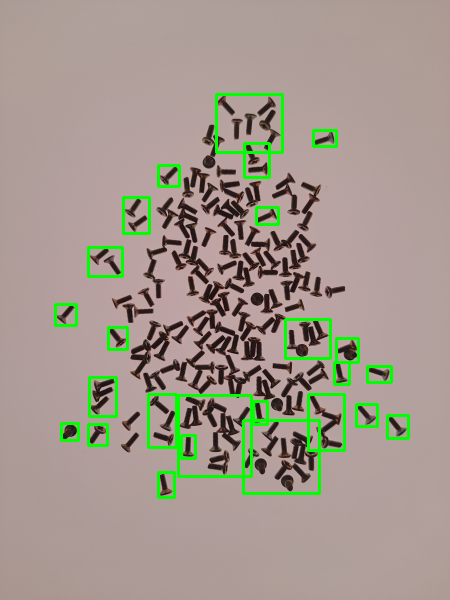

  Estimated screws: 22
  Estimated bolts: 3

Detected objects in 20240713_193839.jpg: 27


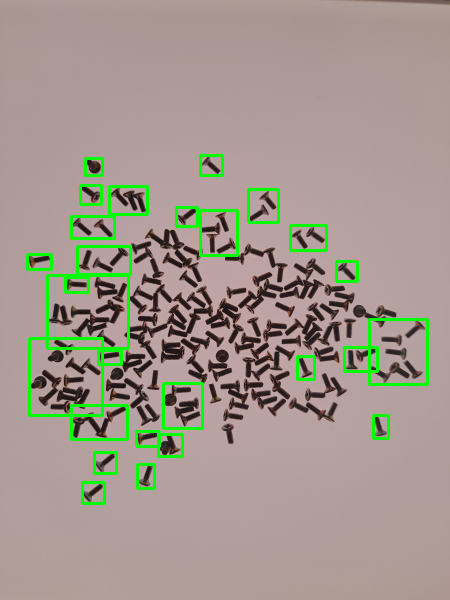

  Estimated screws: 17
  Estimated bolts: 10

Detected objects in 20240713_193907.jpg: 44


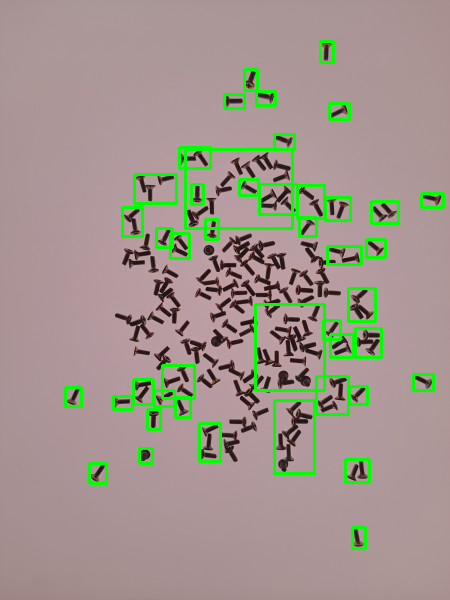

  Estimated screws: 30
  Estimated bolts: 14

Detected objects in 20240713_194206.jpg: 32


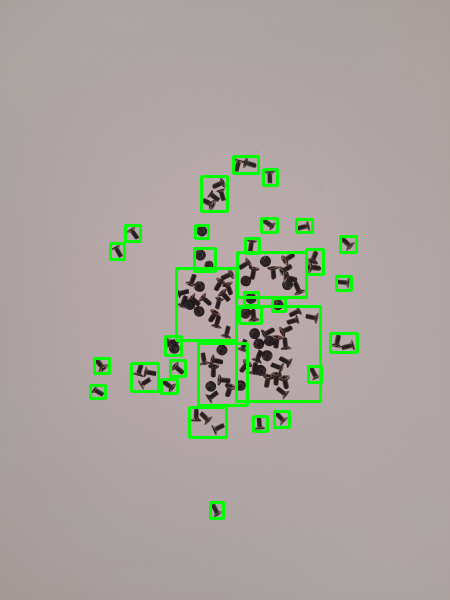

  Estimated screws: 26
  Estimated bolts: 6

Detected objects in 20240713_194215.jpg: 32


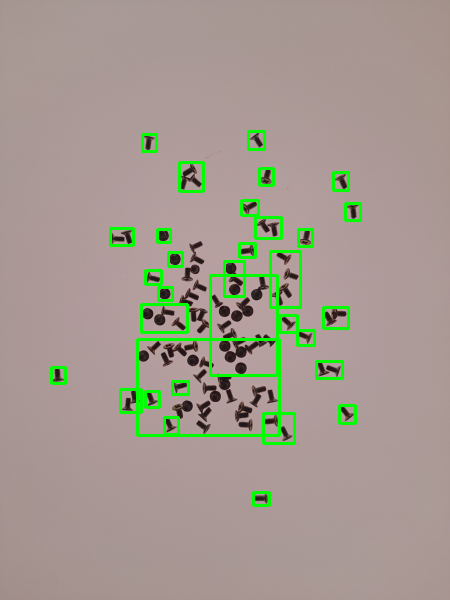

  Estimated screws: 25
  Estimated bolts: 7

Detected objects in 20240713_194232.jpg: 43


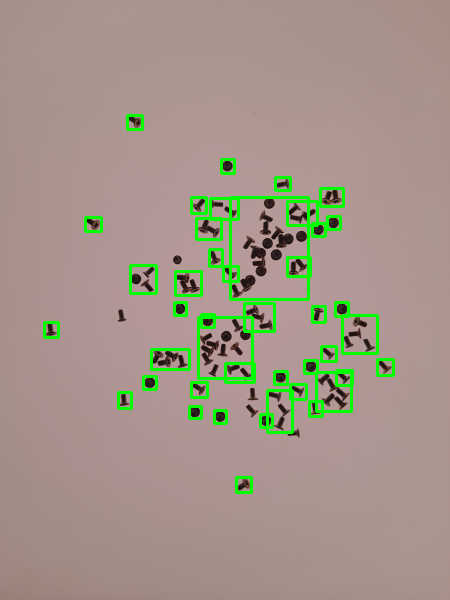

  Estimated screws: 37
  Estimated bolts: 6

Detected objects in 20240713_194256.jpg: 41


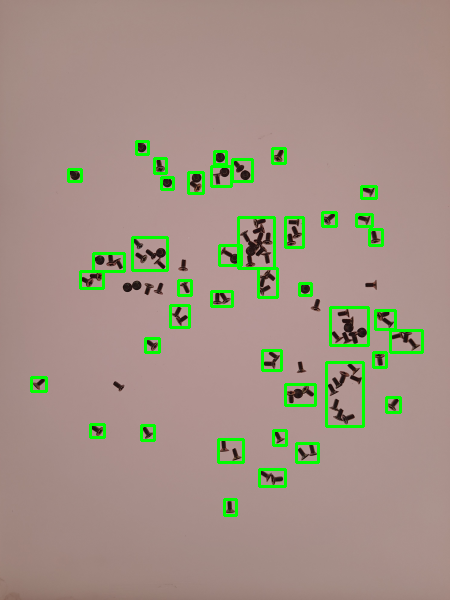

  Estimated screws: 33
  Estimated bolts: 8

Detected objects in 20240713_194316.jpg: 36


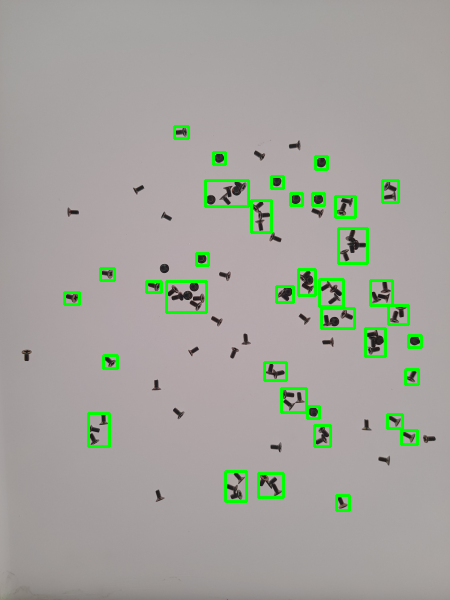

  Estimated screws: 30
  Estimated bolts: 6

Detected objects in 20240713_194541.jpg: 13


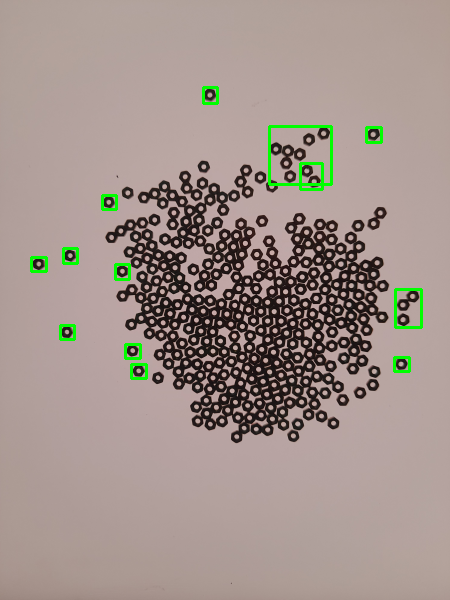

  Estimated screws: 13
  Estimated bolts: 0

Detected objects in 20240713_194551.jpg: 12


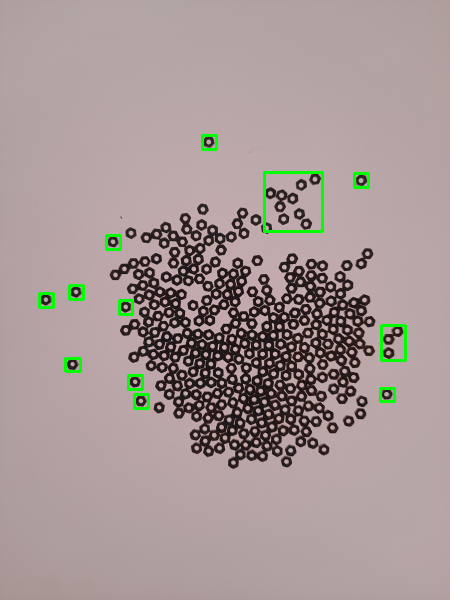

  Estimated screws: 12
  Estimated bolts: 0

Detected objects in 20240713_194606.jpg: 16


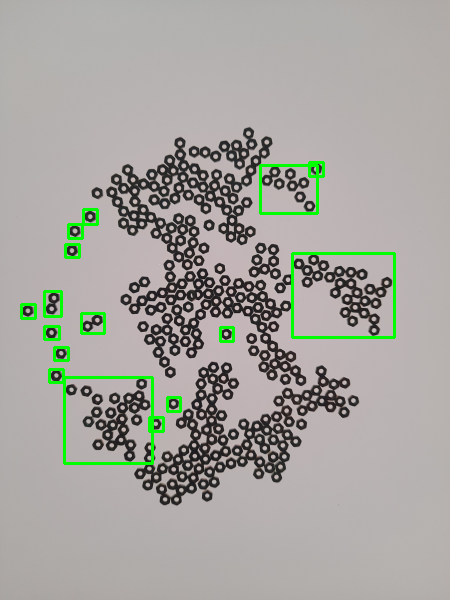

  Estimated screws: 15
  Estimated bolts: 1

Detected objects in 20240713_194621.jpg: 11


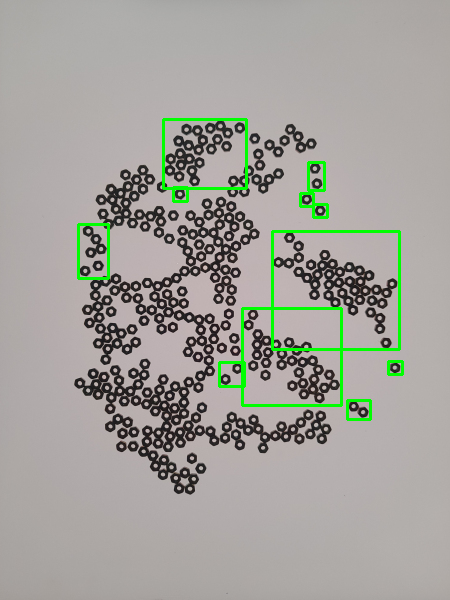

  Estimated screws: 9
  Estimated bolts: 2

Detected objects in 20240713_194630.jpg: 17


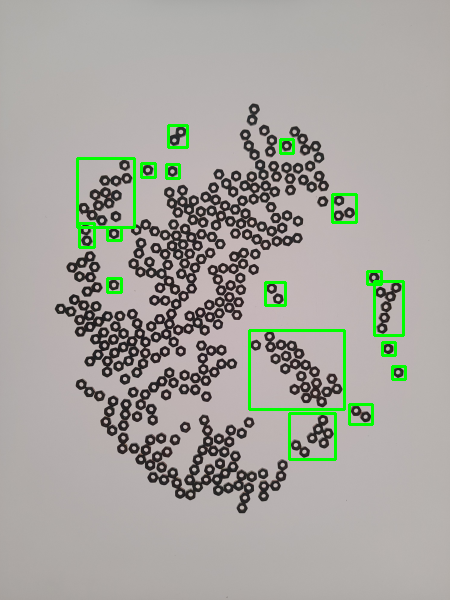

  Estimated screws: 16
  Estimated bolts: 1

Detected objects in 20240713_193650.jpg: 4


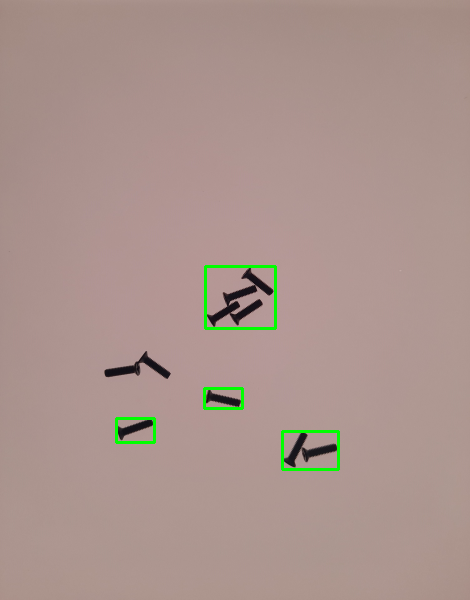

  Estimated screws: 1
  Estimated bolts: 3

Detected objects in 20240713_193135.jpg: 9


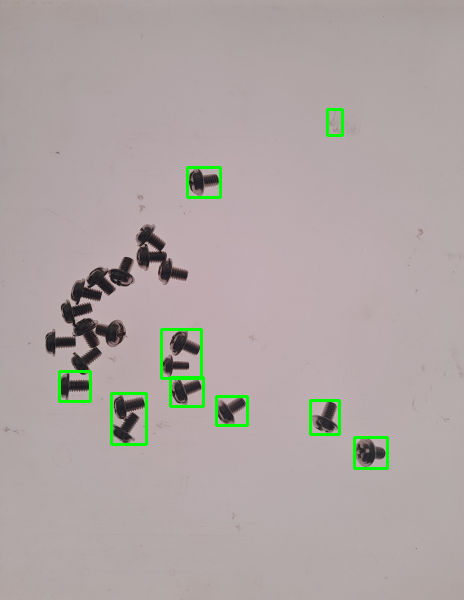

  Estimated screws: 9
  Estimated bolts: 0

Detected objects in 20240713_193659.jpg: 6


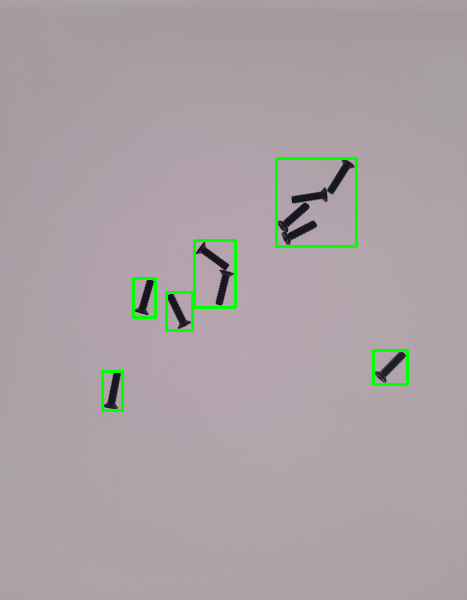

  Estimated screws: 6
  Estimated bolts: 0

Detected objects in 20240713_194200.jpg: 33


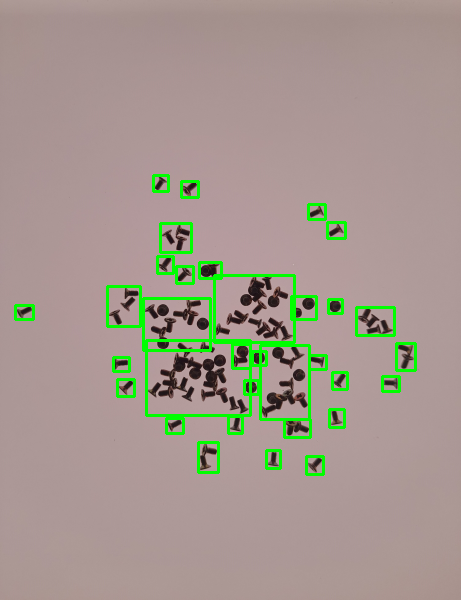

  Estimated screws: 26
  Estimated bolts: 7

Detected objects in 20240713_192951.jpg: 18


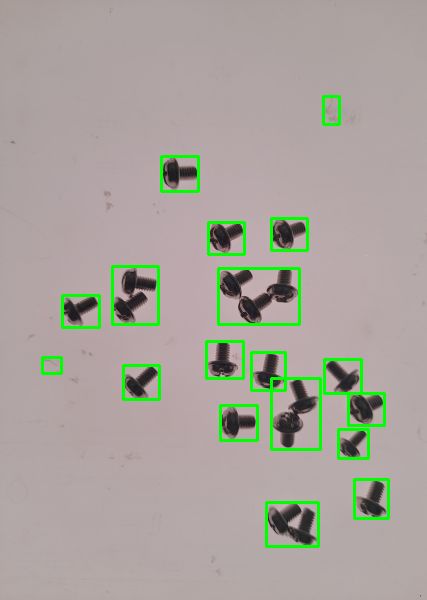

  Estimated screws: 17
  Estimated bolts: 1



In [ ]:
import cv2
import numpy as np
import os
from google.colab.patches import cv2_imshow

def preprocess_image(image, target_size=(800, 600)):
    # Resize image while maintaining aspect ratio
    h, w = image.shape[:2]
    ratio = min(target_size[0] / w, target_size[1] / h)
    new_size = (int(w * ratio), int(h * ratio))
    resized = cv2.resize(image, new_size, interpolation=cv2.INTER_AREA)

    # Convert to grayscale
    gray = cv2.cvtColor(resized, cv2.COLOR_BGR2GRAY)

    # Apply Gaussian blur to reduce noise
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)

    return resized, blurred

def detect_objects(image, min_area=100, max_area=5000):
    # Apply adaptive thresholding
    thresh = cv2.adaptiveThreshold(image, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                   cv2.THRESH_BINARY_INV, 11, 2)

    # Apply morphological operations
    kernel = np.ones((3, 3), np.uint8)
    morph = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel, iterations=2)
    morph = cv2.dilate(morph, kernel, iterations=1)

    # Find contours
    contours, _ = cv2.findContours(morph, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    objects = []
    for contour in contours:
        area = cv2.contourArea(contour)
        if min_area < area < max_area:
            x, y, w, h = cv2.boundingRect(contour)
            aspect_ratio = float(w) / h
            if 0.5 < aspect_ratio < 2.0:  # Adjust as needed
                objects.append((x, y, w, h))

    return objects

# Path to the folder containing images
folder_path = '/content/drive/MyDrive/ScrewAndBolt_20240713'  # Replace with your folder path

# List all files in the folder
image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

for image_file in image_files:
    image_path = os.path.join(folder_path, image_file)
    original_image = cv2.imread(image_path)

    if original_image is None:
        print(f"Error: Unable to load image {image_file}.")
        continue

    # Preprocess the image
    resized_image, processed_image = preprocess_image(original_image)

    # Detect objects
    objects = detect_objects(processed_image)

    # Draw bounding boxes and count objects
    for (x, y, w, h) in objects:
        cv2.rectangle(resized_image, (x, y), (x + w, y + h), (0, 255, 0), 2)

    # Display results
    print(f"Detected objects in {image_file}: {len(objects)}")
    cv2_imshow(resized_image)

    # Classify objects (example)
    screws = [obj for obj in objects if obj[2] / obj[3] < 1.2]  # width/height ratio for roughly circular objects
    bolts = [obj for obj in objects if obj[2] / obj[3] >= 1.2]  # longer objects might be bolts

    print(f"  Estimated screws: {len(screws)}")
    print(f"  Estimated bolts: {len(bolts)}")
    print()

Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2024-8-1 Python-3.10.12 torch-2.3.1+cu121 CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 


Image: img4.jpg
Total objects detected: 13


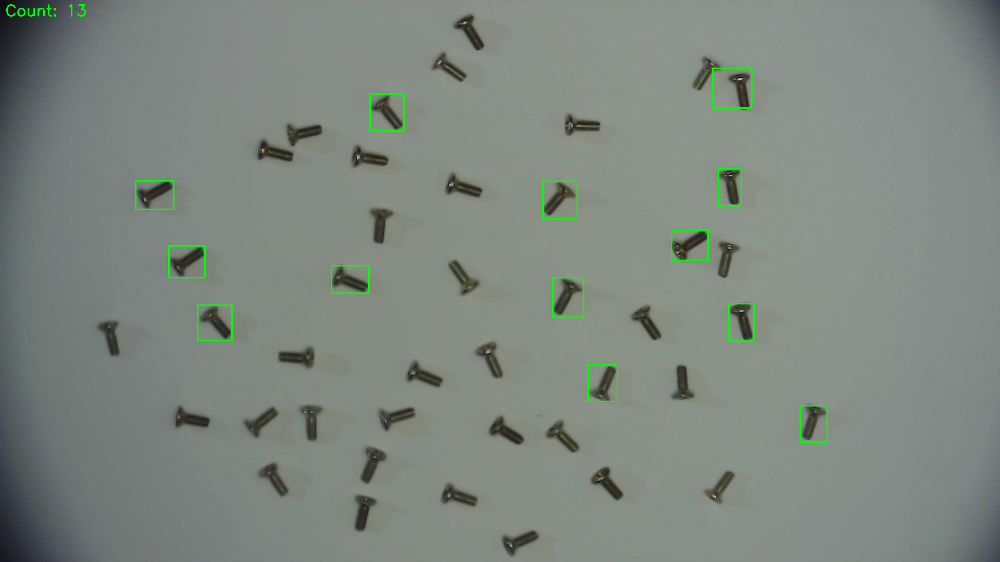

Image: img3.jpg
Total objects detected: 19


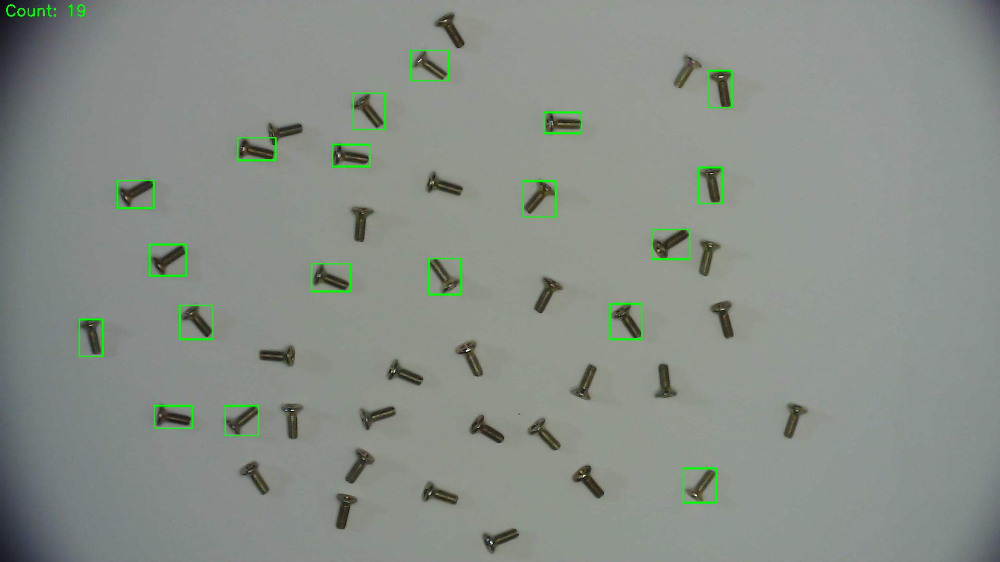

Image: img5.jpg
Total objects detected: 19


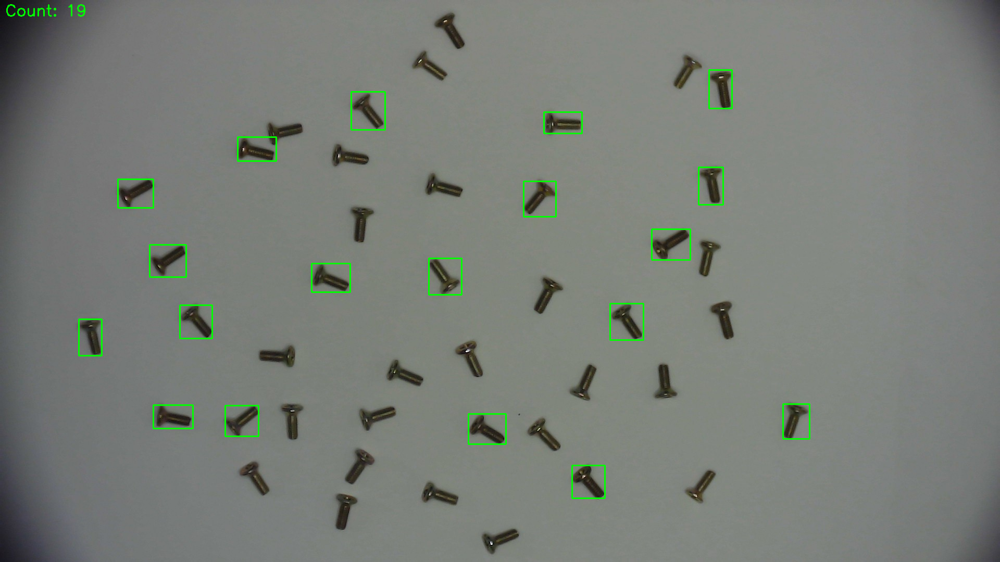

Image: img6.jpg
Total objects detected: 10


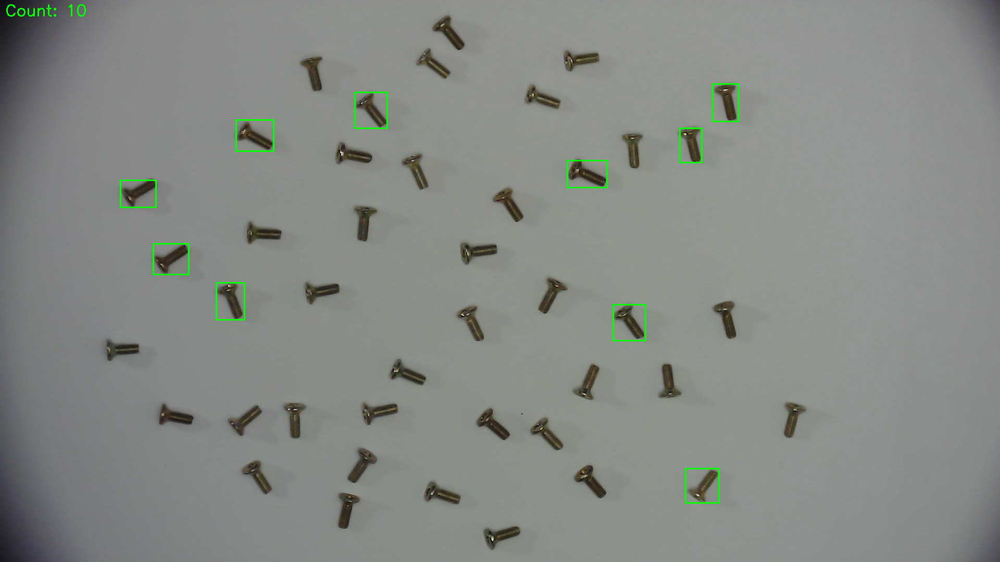

Image: img1_43_nosy.jpg
Total objects detected: 13


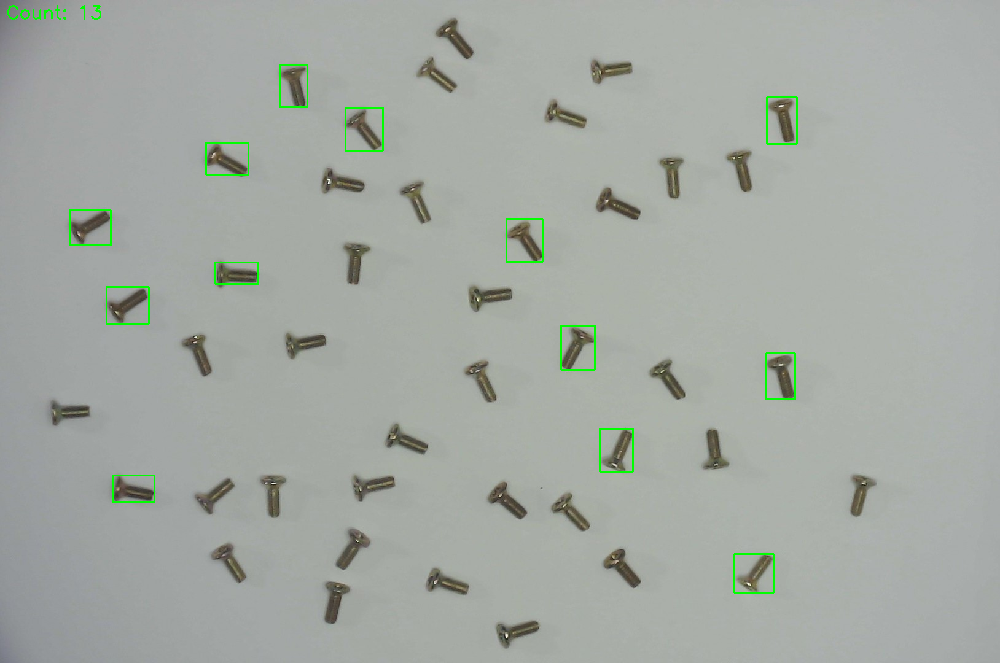

Image: img1.jpg
Total objects detected: 7


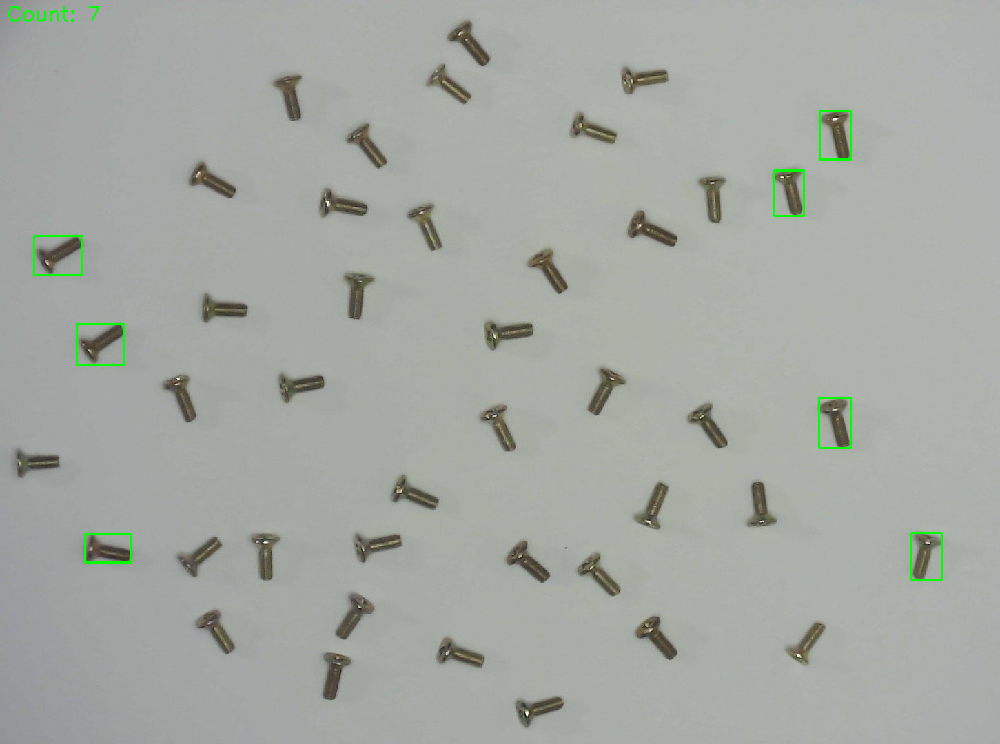

Image: img2.jpg
Total objects detected: 7


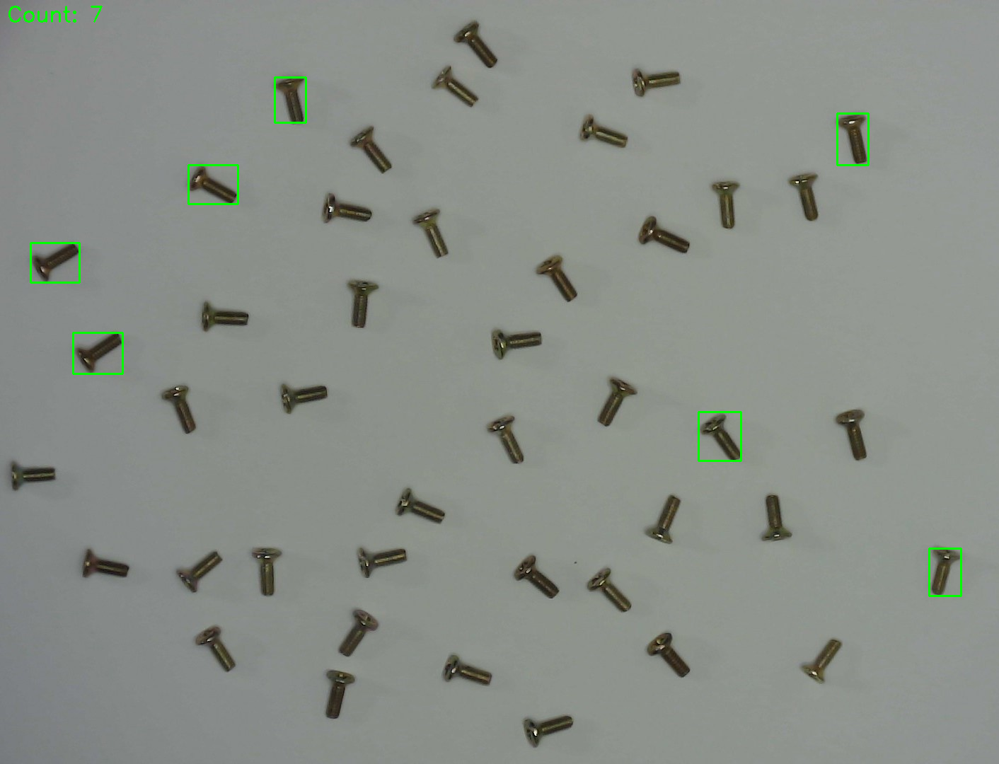

In [14]:
import torch
import cv2
import numpy as np
import os
from google.colab.patches import cv2_imshow

# Load YOLOv5 model
model = torch.hub.load('ultralytics/yolov5', 'yolov5s', pretrained=True)

def process_image(image_path, conf_threshold=0.25, iou_threshold=0.45):
    # Read image
    img = cv2.imread(image_path)

    # Run inference
    results = model(img)

    # Process results
    pred = results.pred[0]
    pred = pred[pred[:, 4] > conf_threshold]  # Filter by confidence

    if pred.shape[0] > 0:
        # Apply Non-Maximum Suppression (NMS) for better accuracy
        boxes = pred[:, :4].tolist()
        scores = pred[:, 4].tolist()
        nms_indices = cv2.dnn.NMSBoxes(boxes, scores, conf_threshold, iou_threshold)

        if len(nms_indices) > 0:
            nms_indices = nms_indices.flatten()  # Flatten the indices array
            pred = pred[nms_indices]

            # Draw bounding boxes and count objects
            count = len(pred)
            for det in pred:
                # Extract bounding box coordinates and convert to integers
                bbox = det[:4].int().numpy()
                x1, y1, x2, y2 = bbox
                cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)
        else:
            count = 0
    else:
        count = 0

    # Add count to image
    cv2.putText(img, f'Count: {count}', (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)

    return img, count

# Path to the folder containing images
folder_path = '/content/drive/MyDrive/Screws_2024_07_15'  # Replace with your folder path

# List all image files
image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

for image_file in image_files:
    image_path = os.path.join(folder_path, image_file)

    # Process image
    result_image, object_count = process_image(image_path)

    # Display results
    print(f"Image: {image_file}")
    print(f"Total objects detected: {object_count}")
    cv2_imshow(result_image)

    # Save result
    result_path = os.path.join('/content/drive/MyDrive/Detected_', image_file)
    cv2.imwrite(result_path, result_image)


Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2024-8-1 Python-3.10.12 torch-2.3.1+cu121 CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 


Image: img4.jpg
Total objects detected: 13


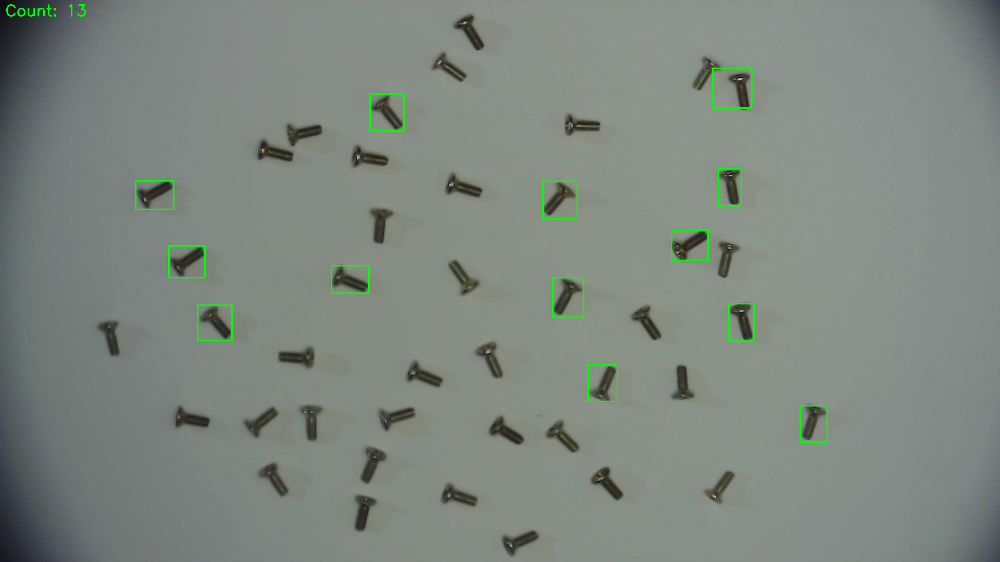

Image: img3.jpg
Total objects detected: 19


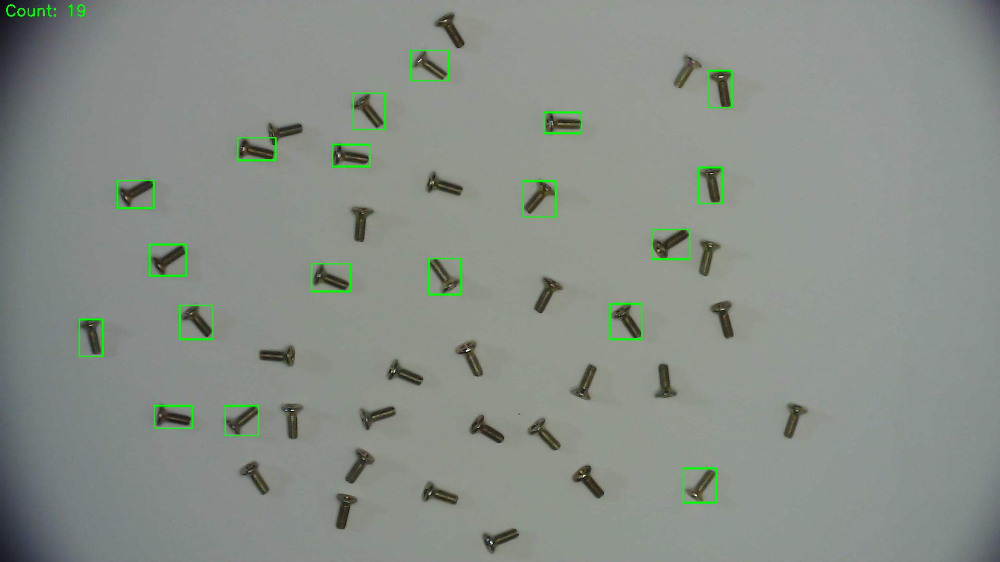

Image: img5.jpg
Total objects detected: 19


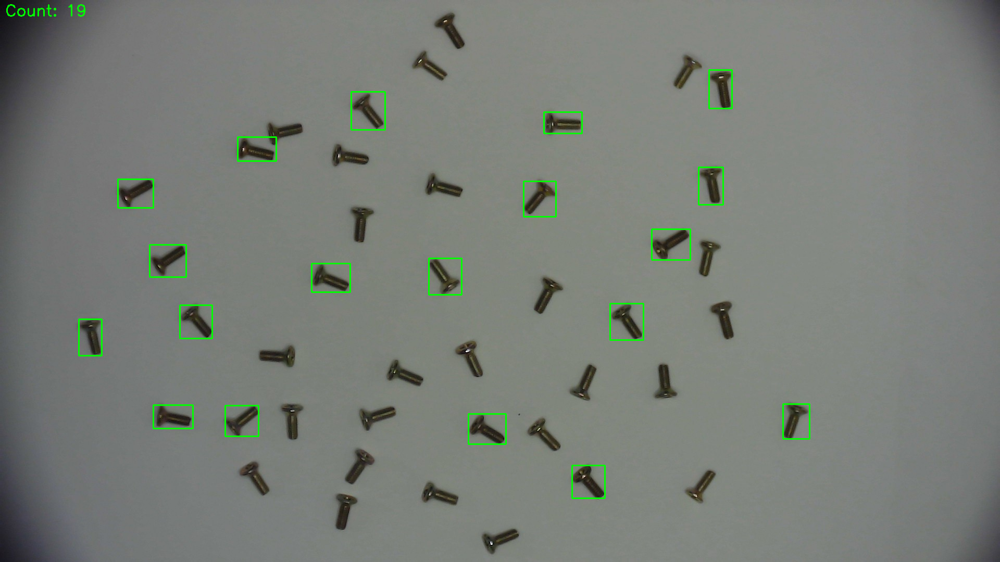

Image: img6.jpg
Total objects detected: 10


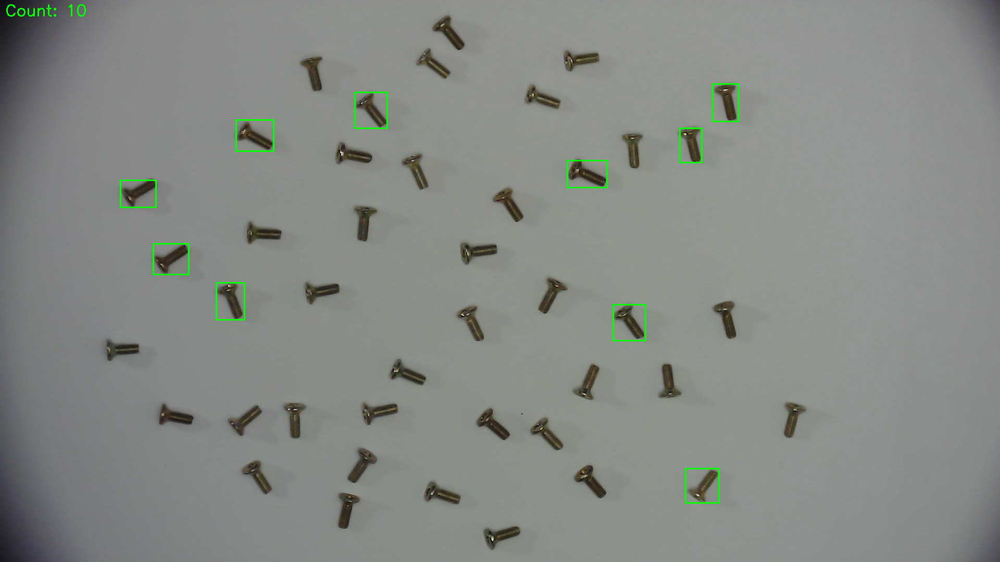

Image: img1_43_nosy.jpg
Total objects detected: 13


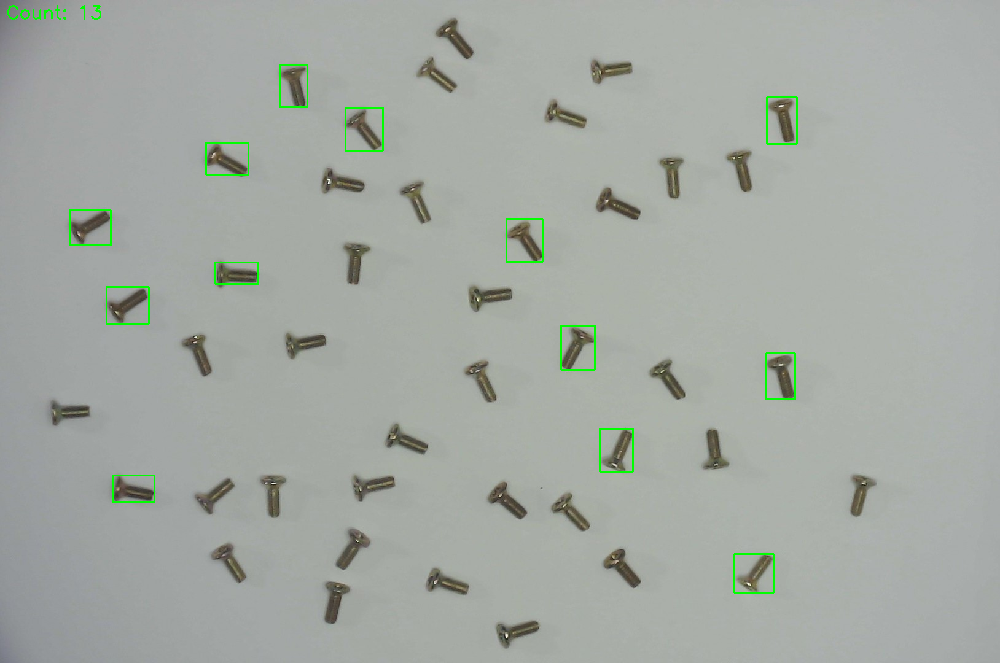

Image: img1.jpg
Total objects detected: 7


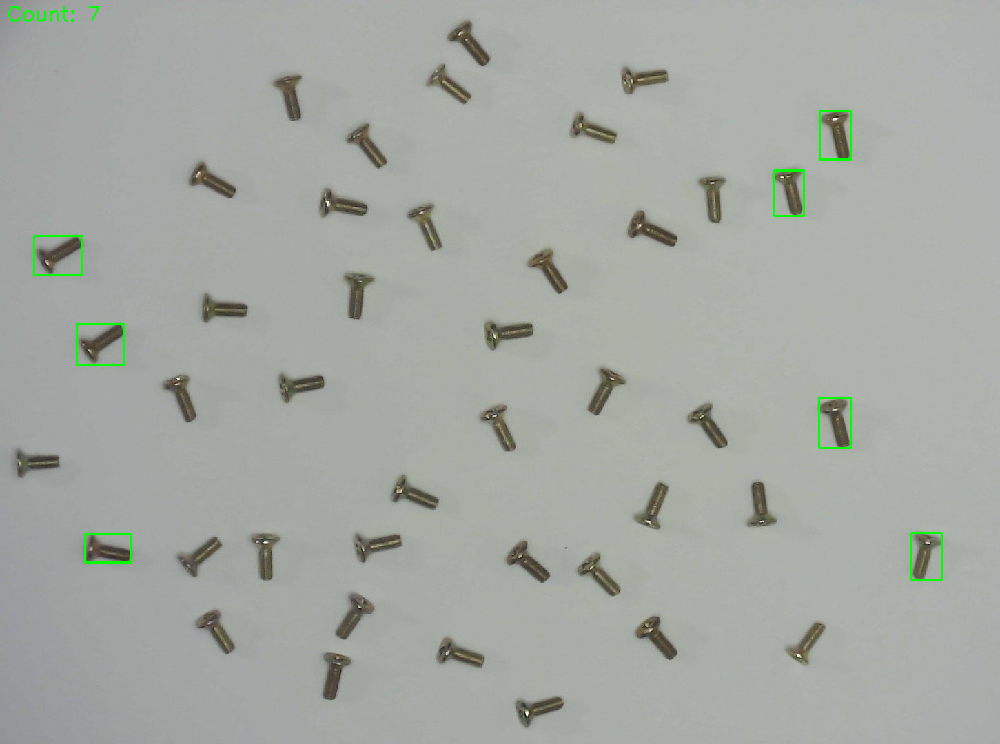

Image: img2.jpg
Total objects detected: 7


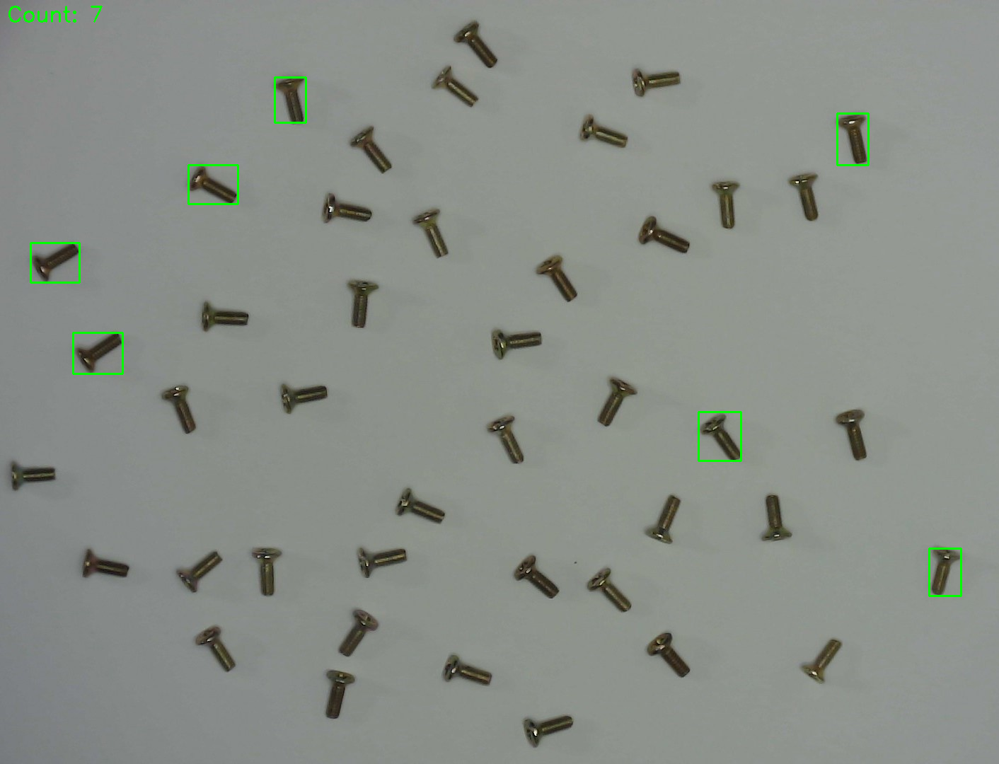

In [17]:
import torch
import cv2
import numpy as np
import os
from google.colab.patches import cv2_imshow

# Load YOLOv5 model
model = torch.hub.load('ultralytics/yolov5', 'yolov5s', pretrained=True)

def process_image(image_path, conf_threshold=0.25, iou_threshold=0.45):
    # Read image
    img = cv2.imread(image_path)

    # Run inference
    results = model(img)

    # Process results
    pred = results.pred[0]
    pred = pred[pred[:, 4] > conf_threshold]  # Filter by confidence

    if pred.shape[0] > 0:
        # Apply Non-Maximum Suppression (NMS) for better accuracy
        boxes = pred[:, :4].tolist()
        scores = pred[:, 4].tolist()
        nms_indices = cv2.dnn.NMSBoxes(boxes, scores, conf_threshold, iou_threshold)

        if len(nms_indices) > 0:
            nms_indices = nms_indices.flatten()  # Flatten the indices array
            pred = pred[nms_indices]

            # Draw bounding boxes and count objects
            count = len(pred)
            for det in pred:
                # Extract bounding box coordinates and convert to integers
                bbox = det[:4].int().numpy()
                x1, y1, x2, y2 = bbox
                cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)
        else:
            count = 0
    else:
        count = 0

    # Add count to image
    cv2.putText(img, f'Count: {count}', (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)

    return img, count

# Path to the folder containing images
folder_path = '/content/drive/MyDrive/Screws_2024_07_15'  # Replace with your folder path

# List all image files
image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

for image_file in image_files:
    image_path = os.path.join(folder_path, image_file)

    # Process image
    result_image, object_count = process_image(image_path)

    # Display results
    print(f"Image: {image_file}")
    print(f"Total objects detected: {object_count}")
    cv2_imshow(result_image)

    # Save result
    result_path = os.path.join('/content/drive/MyDrive/Detected_', image_file)
    cv2.imwrite(result_path, result_image)